# controlnet

In [1]:
import os
weights_dir = os.path.join(os.getcwd(), "weights")
os.makedirs(weights_dir, exist_ok=True)

In [2]:
from controlnet_aux import OpenposeDetector
from diffusers.utils import load_image

openpose = OpenposeDetector.from_pretrained("lllyasviel/ControlNet", cache_dir=weights_dir)

openpose_image = load_image(
    "https://huggingface.co/datasets/huggingface/documentation-images/resolve/main/diffusers/person.png"
)
openpose_image = openpose(openpose_image).resize((1024, 1024))

/workspace/env/lib/python3.11/site-packages/timm/models/layers/__init__.py:48: FutureWarning: Importing from timm.models.layers is deprecated, please import via timm.layers
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.layers", FutureWarning)
/workspace/env/lib/python3.11/site-packages/timm/models/registry.py:4: FutureWarning: Importing from timm.models.registry is deprecated, please import via timm.models
  warnings.warn(f"Importing from {__name__} is deprecated, please import via timm.models", FutureWarning)
/workspace/env/lib/python3.11/site-packages/controlnet_aux/segment_anything/modeling/tiny_vit_sam.py:654: UserWarning: Overwriting tiny_vit_5m_224 in registry with controlnet_aux.segment_anything.modeling.tiny_vit_sam.tiny_vit_5m_224. This is because the name being registered conflicts with an existing name. Please check if this is not expected.
  return register_model(fn_wrapper)
/workspace/env/lib/python3.11/site-packages/controlnet_aux/segme

In [3]:
sum(p.numel() for p in openpose.body_estimation.model.parameters()), sum(p.numel() for p in openpose.hand_estimation.model.parameters()), sum(p.numel() for p in openpose.face_estimation.model.parameters())  # (52,311,446, 36,832,324, 38,425,706)

(52311446, 36832324, 38425706)

In [ ]:
from diffusers import StableDiffusionXLControlNetPipeline, ControlNetModel, AutoencoderKL, UniPCMultistepScheduler
import torch

controlnet = ControlNetModel.from_pretrained("thibaud/controlnet-openpose-sdxl-1.0", torch_dtype=torch.bfloat16, cache_dir=weights_dir)

vae = AutoencoderKL.from_pretrained("madebyollin/sdxl-vae-fp16-fix", torch_dtype=torch.bfloat16, use_safetensors=True, cache_dir=weights_dir).to("cuda")
pipe = StableDiffusionXLControlNetPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0", controlnet=controlnet, torch_dtype=torch.bfloat16, use_safetensors=True, cache_dir=weights_dir
).to("cuda")
# pipe.scheduler = UniPCMultistepScheduler.from_config(pipe.scheduler.config)
from diffusers import DDIMScheduler
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)
pipe.vae = vae
# pipe.enable_model_cpu_offload()

  0%|          | 0/50 [00:00<?, ?it/s]

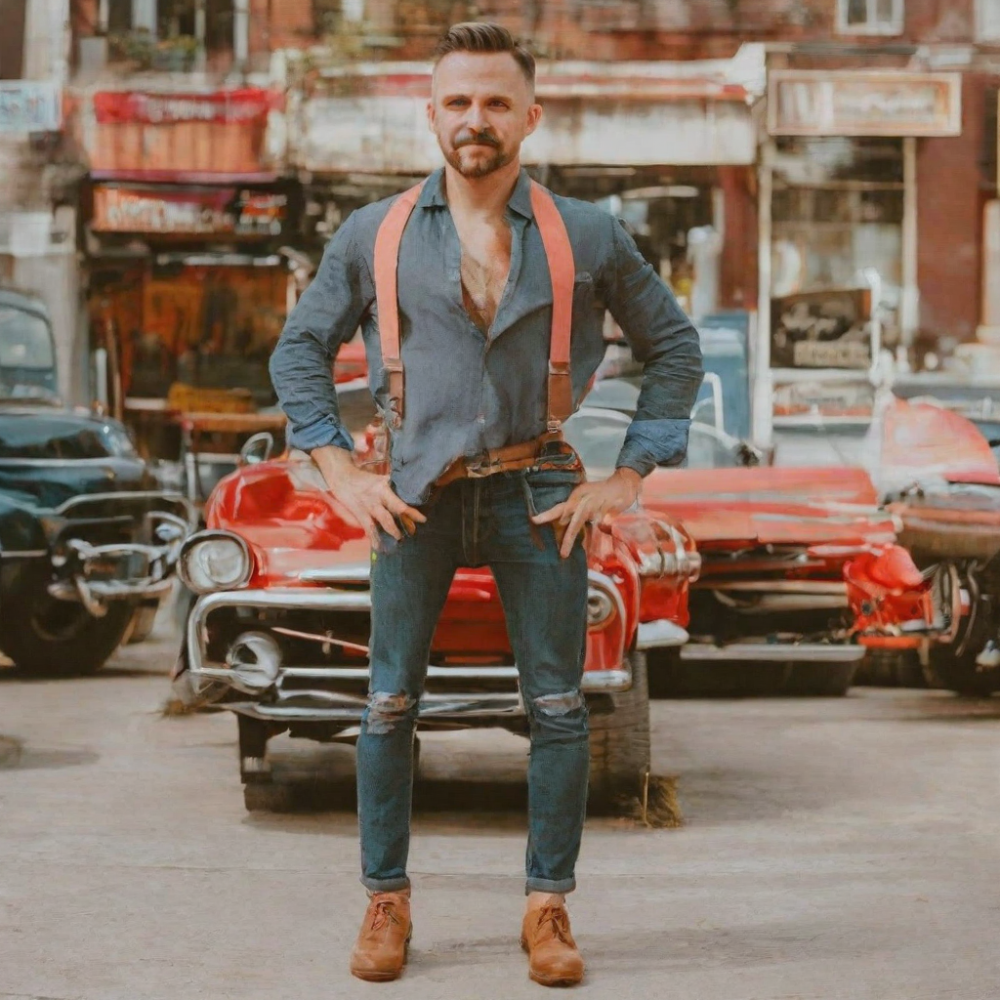

In [9]:
prompt = "a giant standing in a fantasy landscape, best quality"
prompt = "man infront of the red car, wearing blue dress"
negative_prompt = "monochrome, lowres, bad anatomy, worst quality, low quality"

generator = torch.manual_seed(1)

images = [openpose_image]

images = pipe(
    prompt,
    image=images,
    num_inference_steps=50,
    generator=generator,
    negative_prompt=negative_prompt,
    num_images_per_prompt=1,
    controlnet_conditioning_scale=1.0,
    guidance_scale = 3.5
).images[0]
images

  0%|          | 0/50 [00:00<?, ?it/s]

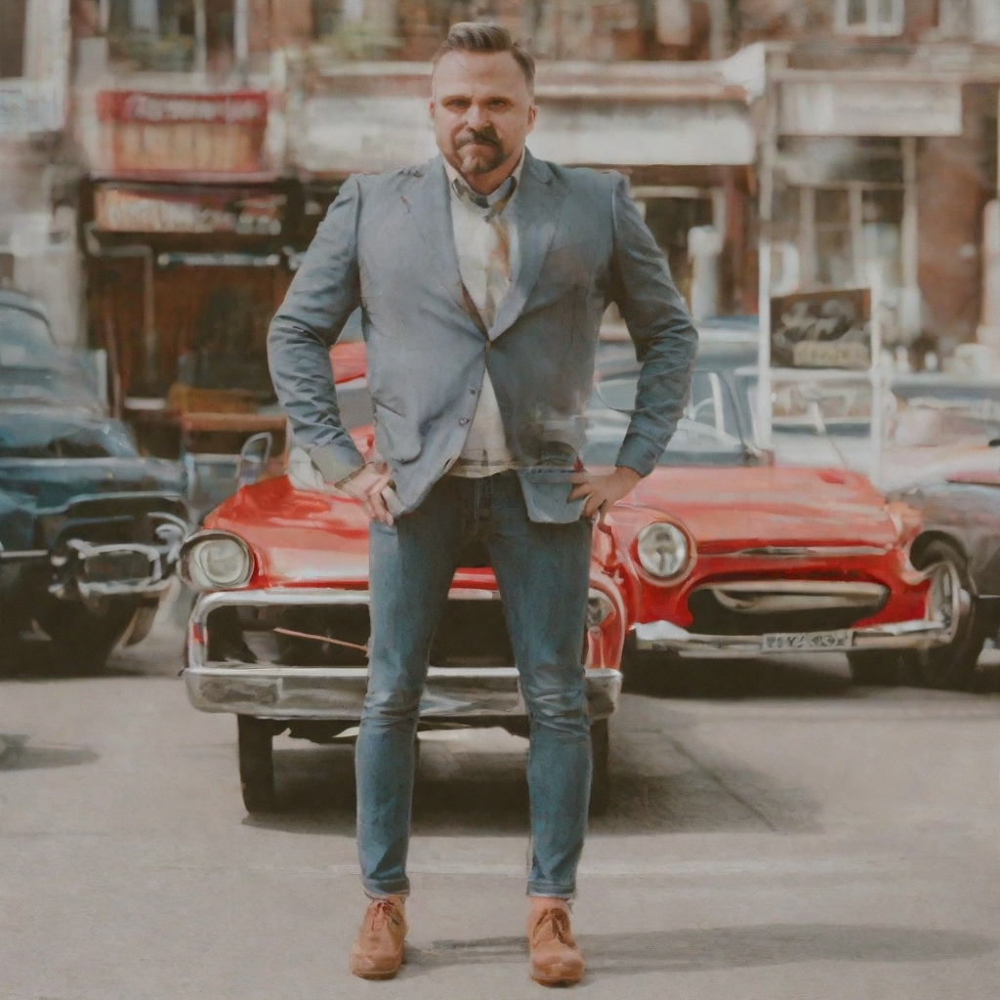

In [11]:
prompt = "a beautiful women standing in front of bar"
prompt = "man infront of the red car, wearing blue dress"
negative_prompt = "monochrome, lowres, bad anatomy, worst quality, low quality"

generator = torch.manual_seed(1)

images = openpose_image

images = pipe(
    prompt,
    image=images,
    num_inference_steps=50,
    generator=generator,
    # negative_prompt=negative_prompt,
    guidance_scale = 3.5,
    cond_scale = 0.5
).images[0]
images

In [34]:
import torch
import requests
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from io import BytesIO
from tqdm.auto import tqdm
from matplotlib import pyplot as plt
from torchvision import transforms as tfms
from diffusers import StableDiffusionPipeline, DDIMScheduler, StableDiffusionXLPipeline
from diffusers import DiffusionPipeline

device = torch.device("mps" if torch.backends.mps.is_available() else "cuda:0" if torch.cuda.is_available() else "cpu")

import torch
import numpy as np
from PIL import Image

def to_pil_image(image):
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.to(dtype=torch.float32)
    image = image.permute(1, 2, 0).detach().cpu().numpy() # (3, 512, 512) -> (512, 512, 3)
    image = (image * 255).round().astype("uint8")
    image = Image.fromarray(image)
    return image

def from_pil_image(image, dtype = torch.bfloat16, device = "cuda", zero_to_one = False):
    arr = np.array(image).astype(np.float32) / 255.0
    tensor = torch.from_numpy(arr).permute(2, 0, 1) # (512, 512, 3) -> (3, 512, 512)
    if not zero_to_one:
        tensor = tensor * 2 - 1
    return tensor.to(dtype=dtype, device=device)

# Sample function (regular DDIM)
@torch.no_grad()
def sample_controlnet(
    prompt,
    controlnet_image,
    start_step=0,
    start_latents=None,
    guidance_scale=3.5,
    num_inference_steps=50,
    num_images_per_prompt=1,
    do_classifier_free_guidance=True,
    negative_prompt="",
    device='cuda',
    output_type = "pil"
):

    (prompt_embeds,negative_prompt_embeds,pooled_prompt_embeds,negative_pooled_prompt_embeds,) = pipe.encode_prompt(
        prompt, device = device, num_images_per_prompt = num_images_per_prompt, do_classifier_free_guidance = do_classifier_free_guidance, negative_prompt = negative_prompt
    )

    height, width = controlnet_image.shape[-2:]

    add_time_ids = torch.tensor([(height, width) + (0, 0) + (height, width)], dtype=pipe.dtype, device=device)
    add_text_embeds = pooled_prompt_embeds
    if do_classifier_free_guidance:
        prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds], dim=0)
        add_text_embeds = torch.cat([negative_pooled_prompt_embeds, pooled_prompt_embeds], dim=0)
        batch_size = 1
        add_time_ids = torch.cat([add_time_ids, add_time_ids], dim=0)
    add_time_ids = add_time_ids.repeat(batch_size * num_images_per_prompt, 1)

    controlnet_image = controlnet_image.repeat_interleave(num_images_per_prompt, dim=0)
    # if do_classifier_free_guidance:
    #     controlnet_image = torch.cat([controlnet_image] * 2)

    added_cond_kwargs = {"text_embeds": add_text_embeds, "time_ids": add_time_ids}

    pipe.scheduler.set_timesteps(num_inference_steps, device=device)

    if start_latents is None:
        start_latents = torch.randn(1, 4, 128, 128, device=device, dtype=pipe.dtype)

    latents = start_latents.clone()

    for i in tqdm(range(start_step, num_inference_steps)):

        t = pipe.scheduler.timesteps[i]

        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t) # does nothing for DDIM scheduler

        control_model_input = latent_model_input
        controlnet_prompt_embeds = prompt_embeds
        controlnet_added_cond_kwargs = added_cond_kwargs

        down_block_res_samples, mid_block_res_sample = pipe.controlnet(
            control_model_input,
            t,
            encoder_hidden_states=controlnet_prompt_embeds,
            controlnet_cond=controlnet_image,
            conditioning_scale=1.0,
            added_cond_kwargs=controlnet_added_cond_kwargs,
            return_dict=False,
        )

        noise_pred = pipe.unet(
            latent_model_input,
            t,
            encoder_hidden_states=prompt_embeds,
            added_cond_kwargs = added_cond_kwargs,
            down_block_additional_residuals=down_block_res_samples,
            mid_block_additional_residual=mid_block_res_sample,
            )[0]

        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample

        # prev_t = t.item() - (1000 // num_inference_steps)  # t-1 -> pipe.scheduler.timesteps[i+1]
        # alpha_t = pipe.scheduler.alphas_cumprod[t.item()]
        # if t == 1:
        #     alpha_t_prev = torch.tensor(1.0)
        # else:
        #     alpha_t_prev = pipe.scheduler.alphas_cumprod[prev_t]
        # predicted_x0 = (latents - (1 - alpha_t).sqrt() * noise_pred) / alpha_t.sqrt()
        # direction_pointing_to_xt = (1 - alpha_t_prev).sqrt() * noise_pred
        # latents = alpha_t_prev.sqrt() * predicted_x0 + direction_pointing_to_xt
        
    if output_type == "pil":
        images = pipe.vae.decode(latents / pipe.vae.config.scaling_factor, return_dict=False)[0]
        images = [to_pil_image(img) for img in images]
        return images
    else:
        return latents

  0%|          | 0/50 [00:00<?, ?it/s]

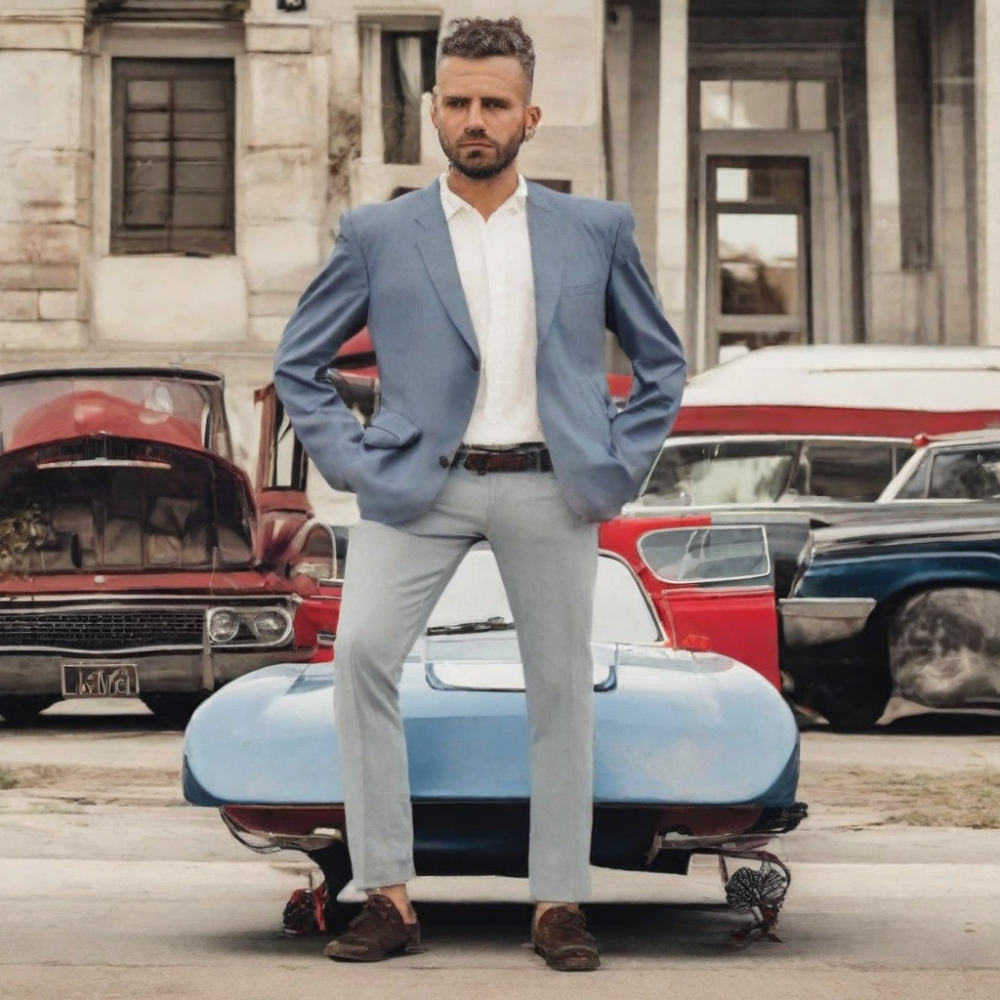

In [44]:
sample_controlnet("man infront of the red car, wearing blue dress", from_pil_image(openpose_image, zero_to_one = True), guidance_scale = 5.0)[0]

# inversion

In [1]:
import os
weights_dir = os.path.join(os.getcwd(), "weights")
os.makedirs(weights_dir, exist_ok=True)

In [2]:
import torch
import requests
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from io import BytesIO
from tqdm.auto import tqdm
from matplotlib import pyplot as plt
from torchvision import transforms as tfms
from diffusers import StableDiffusionPipeline, DDIMScheduler, StableDiffusionXLPipeline
from diffusers import DiffusionPipeline

device = torch.device("mps" if torch.backends.mps.is_available() else "cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
# pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5", cache_dir=weights_dir).to(device)
pipe = StableDiffusionXLPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.bfloat16, use_safetensors=True, cache_dir=weights_dir).to(device)
pipe = StableDiffusionXLPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.bfloat16, use_safetensors=True, cache_dir=weights_dir).to(device)
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

In [ ]:
# Sample an image to make sure it is all working
prompt = "Beautiful DSLR Photograph of a penguin on the beach, golden hour"
prompt = "image of person standing in front of a red car"
negative_prompt = "blurry, ugly, stock photo"
im = pipe(prompt, negative_prompt=negative_prompt).images[0]
# im.resize((256, 256))  # Resize for convenient viewing
im

In [4]:
import torch
import numpy as np
from PIL import Image

def to_pil_image(image):
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.to(dtype=torch.float32)
    image = image.permute(1, 2, 0).detach().cpu().numpy() # (3, 512, 512) -> (512, 512, 3)
    image = (image * 255).round().astype("uint8")
    image = Image.fromarray(image)
    return image

def from_pil_image(image, dtype = torch.bfloat16, device = "cuda"):
    arr = np.array(image).astype(np.float32) / 255.0
    tensor = torch.from_numpy(arr).permute(2, 0, 1) # (512, 512, 3) -> (3, 512, 512)
    tensor = tensor * 2 - 1
    return tensor.to(dtype=dtype, device=device)

In [ ]:
# Sample function (regular DDIM)
@torch.no_grad()
def sample(
    prompt,
    start_step=0,
    start_latents=None,
    guidance_scale=3.5,
    num_inference_steps=50,
    num_images_per_prompt=1,
    do_classifier_free_guidance=True,
    negative_prompt="",
    device=device,
    output_type = "pil"
):

    (prompt_embeds,negative_prompt_embeds,pooled_prompt_embeds,negative_pooled_prompt_embeds) = pipe.encode_prompt(
        prompt, device = device, num_images_per_prompt = num_images_per_prompt, do_classifier_free_guidance = do_classifier_free_guidance, negative_prompt = negative_prompt
    )

    add_time_ids = torch.tensor([1024, 1024, 0, 0, 1024, 1024], dtype=pipe.dtype, device=device)
    add_text_embeds = pooled_prompt_embeds
    if do_classifier_free_guidance:
        prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds], dim=0)
        add_text_embeds = torch.cat([negative_pooled_prompt_embeds, pooled_prompt_embeds], dim=0)
        batch_size = 1
        add_time_ids = torch.cat([add_time_ids, add_time_ids], dim=0).repeat(batch_size * num_images_per_prompt, 1)

    added_cond_kwargs = {"text_embeds": add_text_embeds, "time_ids": add_time_ids}

    pipe.scheduler.set_timesteps(num_inference_steps, device=device)

    if start_latents is None:
        start_latents = torch.randn(1, 4, 128, 128, device=device, dtype=pipe.dtype)

    latents = start_latents.clone()

    for i in tqdm(range(start_step, num_inference_steps)):

        t = pipe.scheduler.timesteps[i]

        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t) # does nothing for DDIM scheduler

        noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=prompt_embeds, added_cond_kwargs = added_cond_kwargs)[0]

        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        # latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample

        prev_t = t.item() - (1000 // num_inference_steps)  # t-1 -> pipe.scheduler.timesteps[i+1]
        alpha_t = pipe.scheduler.alphas_cumprod[t.item()]
        if t == 1:
            alpha_t_prev = torch.tensor(1.0)
        else:
            alpha_t_prev = pipe.scheduler.alphas_cumprod[prev_t]
        predicted_x0 = (latents - (1 - alpha_t).sqrt() * noise_pred) / alpha_t.sqrt()
        direction_pointing_to_xt = (1 - alpha_t_prev).sqrt() * noise_pred
        latents = alpha_t_prev.sqrt() * predicted_x0 + direction_pointing_to_xt
        # prev_t = max(1, t.item() - (1000 // num_inference_steps))  # t-1 -> pipe.scheduler.timesteps[i+1]
        # alpha_t = pipe.scheduler.alphas_cumprod[t.item()]
        # alpha_t_prev = pipe.scheduler.alphas_cumprod[prev_t]
        # predicted_x0 = (latents - (1 - alpha_t).sqrt() * noise_pred) / alpha_t.sqrt()
        # direction_pointing_to_xt = (1 - alpha_t_prev).sqrt() * noise_pred
        # latents = alpha_t_prev.sqrt() * predicted_x0 + direction_pointing_to_xt
    if output_type == "pil":
        images = pipe.vae.decode(latents / pipe.vae.config.scaling_factor, return_dict=False)[0]
        images = [to_pil_image(img) for img in images]
        return images
    else:
        return latents

In [ ]:
g = torch.Generator(device=device).manual_seed(0)
start_latents = torch.randn(1, 4, 128, 128, device=device, dtype=pipe.dtype, generator=g)
negative_prompt = "blurry, ugly, low-quality, bad anatomy, distorted, deformed, text, watermark, logo, jpeg artifacts, overexposed, underexposed, grainy, pixelated, cartoonish, unrealistic, stock photo, poor lighting"
img = sample("image of person standing in front of a red car, wearing black cap", negative_prompt=negative_prompt, num_inference_steps=50, start_latents=start_latents)[0]
img

In [6]:
from PIL import Image
import requests
from io import BytesIO

def load_image(url, size=None):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    if size:
        img = img.resize(size)
    return img
input_image = load_image("https://images.pexels.com/photos/8306128/pexels-photo-8306128.jpeg", size=(512, 512))
# input_image

In [7]:
# Encoding
# import torchvision.transforms.functional as TF
# tensor = TF.to_tensor(input_image).unsqueeze(0)  # [1,3,H,W] float32 in [0,1]
# tensor = tensor.to(device, dtype=torch.bfloat16) * 2 - 1  # scale to [-1,1] and cast
tensor = from_pil_image(input_image).unsqueeze(0)
latent = pipe.vae.encode(tensor)
    
l = pipe.vae.config.scaling_factor * latent.latent_dist.sample()
l.shape
# decoding
# images = pipe.vae.decode(l / pipe.vae.config.scaling_factor, return_dict=False)[0]
# i = to_pil_image(images[0])
# i

torch.Size([1, 4, 64, 64])

In [ ]:
## Inversion # may be wrong, dont know, need to check
@torch.no_grad()
def invert(
    start_latents,
    prompt,
    num_inference_steps=50,
    invert_till = None,
    num_images_per_prompt=1,
    guidance_scale=3.5,
    do_classifier_free_guidance=True,
    negative_prompt="",
    device="cuda",
):

    (prompt_embeds,negative_prompt_embeds,pooled_prompt_embeds,negative_pooled_prompt_embeds,) = pipe.encode_prompt(
        prompt, device = device, num_images_per_prompt = num_images_per_prompt, do_classifier_free_guidance = do_classifier_free_guidance, negative_prompt = negative_prompt
    )

    add_time_ids = torch.tensor([1024, 1024, 0, 0, 1024, 1024], dtype=pipe.dtype, device=device)
    add_text_embeds = pooled_prompt_embeds
    if do_classifier_free_guidance:
        prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds], dim=0)
        add_text_embeds = torch.cat([negative_pooled_prompt_embeds, pooled_prompt_embeds], dim=0)
        batch_size = 1
        add_time_ids = torch.cat([add_time_ids, add_time_ids], dim=0).repeat(batch_size * num_images_per_prompt, 1)

    added_cond_kwargs = {"text_embeds": add_text_embeds, "time_ids": add_time_ids}

    if not invert_till:
        invert_till = num_inference_steps

    intermediate_latents = []

    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = reversed(pipe.scheduler.timesteps)  # -> [1, 21, 41, ...]
    
    latents = start_latents.clone()

    for i in tqdm(range(1, invert_till), total=invert_till - 1):

        if i >= invert_till - 1:
            continue

        t = timesteps[i]

        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

        noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=prompt_embeds, added_cond_kwargs = added_cond_kwargs)[0]

        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        current_t = max(0, t.item() - (1000 // num_inference_steps))  # t
        next_t = t  # min(999, t.item() + (1000//num_inference_steps)) # t+1
        alpha_t = pipe.scheduler.alphas_cumprod[current_t]
        alpha_t_next = pipe.scheduler.alphas_cumprod[next_t]

        latents = (latents - (1 - alpha_t).sqrt() * noise_pred) * (alpha_t_next.sqrt() / alpha_t.sqrt()) + (
            1 - alpha_t_next
        ).sqrt() * noise_pred

        # intermediate_latents.append(latents)

    # return torch.cat(intermediate_latents)
    return latents

In [ ]:
## Inversion # correct one
@torch.no_grad()
def invert(
    start_latents,
    prompt,
    num_inference_steps=50,
    invert_till = None,
    num_images_per_prompt=1,
    guidance_scale=3.5,
    do_classifier_free_guidance=True,
    negative_prompt="",
    device="cuda",
):

    (prompt_embeds,negative_prompt_embeds,pooled_prompt_embeds,negative_pooled_prompt_embeds) = pipe.encode_prompt(
        prompt, device = device, num_images_per_prompt = num_images_per_prompt, do_classifier_free_guidance = do_classifier_free_guidance, negative_prompt = negative_prompt
    )

    height, width = start_latents.shape[-2:]
    height = height * pipe.vae_scale_factor
    width = width * pipe.vae_scale_factor

    original_size = (height, width)
    target_size = (height, width)
    add_time_ids = torch.tensor([original_size + (0, 0) + target_size], dtype=pipe.dtype, device=device)
    add_text_embeds = pooled_prompt_embeds
    if do_classifier_free_guidance:
        prompt_embeds = torch.cat([negative_prompt_embeds, prompt_embeds], dim=0)
        add_text_embeds = torch.cat([negative_pooled_prompt_embeds, pooled_prompt_embeds], dim=0)
        batch_size = 1
        add_time_ids = torch.cat([add_time_ids, add_time_ids], dim=0).repeat(batch_size * num_images_per_prompt, 1)

    added_cond_kwargs = {"text_embeds": add_text_embeds, "time_ids": add_time_ids}

    if not invert_till:
        invert_till = num_inference_steps

    intermediate_latents = []

    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = reversed(pipe.scheduler.timesteps)  # -> [1, 21, 41, ...]
    
    latents = start_latents.clone()

    for i in tqdm(range(0, invert_till)):
        t = timesteps[i]
        last_t = timesteps[i-1]
        # last_t = t.item() - (1000 // num_inference_steps)

        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

        noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=prompt_embeds, added_cond_kwargs = added_cond_kwargs)[0]

        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        alpha_t = pipe.scheduler.alphas_cumprod[t]
        if last_t == timesteps[-1]:
            alpha_t_last = pipe.scheduler.final_alpha_cumprod
        else:
            alpha_t_last = pipe.scheduler.alphas_cumprod[last_t]

        # latents = (latents - (1 - alpha_t_last).sqrt() * noise_pred) * (alpha_t.sqrt() / alpha_t_last.sqrt()) + (1 - alpha_t).sqrt() * noise_pred
        # sa * ((1 / sb) * x_tm1 + ((1 / a - 1) ** 0.5 - (1 / b - 1) ** 0.5) * eps_xt)
        latents = alpha_t.sqrt() * ((1/alpha_t_last.sqrt()) * latents + ((1/alpha_t - 1).sqrt() - (1/alpha_t_last - 1).sqrt()) * noise_pred)

        # print(t)
        # print(alpha_t)
        # print(alpha_t_last)
        # print(noise_pred)
        # print(latents)
        # print(prompt_embeds)
        # print(added_cond_kwargs['time_ids'])
        # print(added_cond_kwargs['text_embeds'])
        # print(noise_pred.reshape(-1)[:10])
        # print(latents.reshape(-1)[:10])
        # print(prompt_embeds.reshape(-1)[:10])
        # print(added_cond_kwargs['time_ids'].reshape(-1)[:10])
        # print(added_cond_kwargs['text_embeds'].reshape(-1)[:10])

        # intermediate_latents.append(latents)

    # return torch.cat(intermediate_latents)
    return latents

In [5]:
prompt = "Photograph of a puppy on the grass"
(prompt_embeds,negative_prompt_embeds,pooled_prompt_embeds,negative_pooled_prompt_embeds) = pipe.encode_prompt(
        prompt, device = "cuda", num_images_per_prompt = 1, do_classifier_free_guidance = False, negative_prompt = ""
    )

height, width = latents_2.shape[-2:]
height = height * pipe1.vae_scale_factor
width = width * pipe1.vae_scale_factor

original_size = (height, width)
target_size = (height, width)
add_time_ids = torch.tensor([original_size + (0, 0) + target_size], dtype=pipe.dtype, device='cuda')
add_text_embeds = pooled_prompt_embeds
added_cond_kwargs = {"text_embeds": add_text_embeds, "time_ids": add_time_ids}
timesteps = reversed(pipe.scheduler.timesteps)
t = timesteps[0]
# noise_pred1 = pipe.unet(latents_2, t, encoder_hidden_states=prompt_embeds, added_cond_kwargs = added_cond_kwargs)[0]
noise_pred2 = pipe1.unet(latents_2, t, encoder_hidden_states=prompt_embeds, added_cond_kwargs = added_cond_kwargs, cross_attention_kwargs = None, return_dict = False)[0]
# print(noise_pred1.reshape(-1)[:10])
print(noise_pred2.reshape(-1)[:10])
# torch.equal(noise_pred1, noise_pred2)

tensor([-0.4531, -0.9141,  0.2754,  0.1514, -0.1504,  0.3164,  0.4121,  0.3848,
         0.3867,  1.3594], device='cuda:0', dtype=torch.bfloat16,
       grad_fn=<SliceBackward0>)


In [ ]:
def compare_models(model_a, model_b, rtol=1e-5, atol=1e-8):
    for (name_a, param_a), (name_b, param_b) in zip(model_a.named_parameters(),
                                                    model_b.named_parameters()):
        if name_a != name_b:
            print(f"⚠️ Mismatch in parameter name: {name_a} vs {name_b}")
            return False

        if not torch.equal(param_a, param_b):
            print(f"❌ Values differ for parameter: {name_a}")
            return False
    print("✅ All parameters match")
    return True


# Example usage:
same = compare_models(pipe.unet, pipe1.unet)

  0%|          | 0/40 [00:00<?, ?it/s]

100%|██████████| 40/40 [00:02<00:00, 14.28it/s]


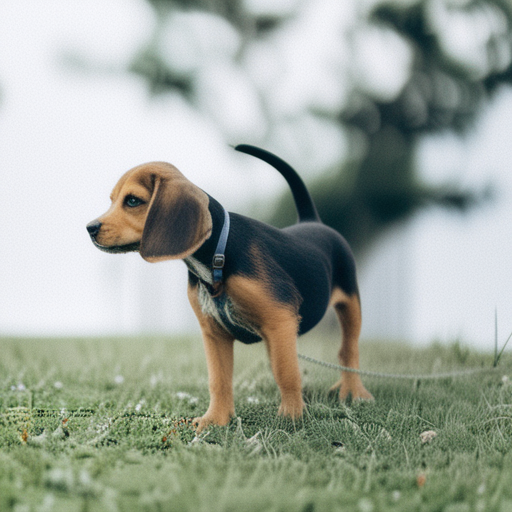

In [30]:
from tqdm import tqdm
input_image_prompt = "Photograph of a puppy on the grass"
invert_till = 40
inverted_latents = invert(
    l,
    input_image_prompt,
    num_inference_steps=50,
    invert_till=invert_till,
    do_classifier_free_guidance = False
    )
sample(prompt = "Photograph of a puppy on the grass", start_step=50 - invert_till, start_latents = inverted_latents.clone(), do_classifier_free_guidance = False)[0]

In [ ]:
from diffusers import StableDiffusionXLImg2ImgPipeline
image = pipe.image_processor.preprocess(input_image)
# g = torch.Generator(device=device).manual_seed(0)
temp_pipe = StableDiffusionXLImg2ImgPipeline(
    vae = pipe.vae,
    text_encoder = None,
    text_encoder_2 = None,
    tokenizer = None,
    tokenizer_2 = None,
    unet = None,
    scheduler = None,
)
latents = temp_pipe.prepare_latents(
    image,
    None,
    1,
    1,
    torch.bfloat16,
    'cuda',
    None,
    False
)
latents.shape , torch.allclose(latents, l, rtol=1e-6, atol=1e-6)

(torch.Size([1, 4, 64, 64]), False)

In [ ]:
tensor = from_pil_image(input_image, dtype = torch.float32).unsqueeze(0)
pipe.vae.to(dtype = torch.float32)
latent = pipe.vae.encode(tensor)
l = pipe.vae.config.scaling_factor * latent.latent_dist.sample()
l.shape, torch.allclose(l.to(torch.bfloat16), latents_2, rtol=1e-6, atol=1e-6)

(torch.Size([1, 4, 64, 64]), False)

In [20]:
from PIL import Image
import requests
from io import BytesIO
from pnp_pipeline import SDXLDDIMPipeline
import torch
import os

weights_dir = os.path.join(os.getcwd(), "weights")
pipe1 = SDXLDDIMPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.bfloat16,
    use_safetensors=True,
    # variant="fp16",
    cache_dir = weights_dir
).to("cuda")

latents_2 = pipe1.prepare_latents(
    pipe1.image_processor.preprocess(input_image),
    None,
    1,
    1,
    torch.bfloat16,
    'cuda',
    None,
    False
)
latents_2.shape , torch.allclose(latents, latents_2, rtol=1e-6, atol=1e-6)

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

(torch.Size([1, 4, 64, 64]), False)

In [ ]:
x = pipe1(prompt = "Photograph of a puppy on the grass", image = input_image)
pipe(prompt = "Photograph of a puppy on the grass", latents = x[0].clone(), guidance_scale = 1 ).images[0]

In [6]:
noise_pred2

tensor([[[[-4.5312e-01, -9.1406e-01,  2.7539e-01,  ..., -1.0107e-01,
            1.2891e-01, -2.0508e-01],
          [-2.4902e-01,  3.9258e-01, -4.3555e-01,  ...,  2.7148e-01,
            4.9316e-02,  3.6133e-01],
          [ 4.1211e-01, -1.1963e-01,  3.2617e-01,  ...,  4.4727e-01,
           -5.7812e-01, -1.3379e-01],
          ...,
          [-9.9121e-02,  1.5137e-02,  3.1641e-01,  ..., -1.1250e+00,
           -7.7148e-02,  2.0020e-01],
          [ 1.5039e-01, -9.9121e-02,  7.5684e-02,  ...,  4.2969e-01,
            3.0664e-01,  1.9531e-02],
          [-6.3281e-01, -3.9062e-02,  3.5938e-01,  ..., -1.0234e+00,
            4.1797e-01,  2.9102e-01]],

         [[-1.7700e-02, -5.9509e-04,  5.5908e-02,  ..., -8.1055e-02,
            8.3984e-01,  2.2559e-01],
          [ 2.6172e-01, -7.8516e-01,  4.6875e-01,  ..., -5.3516e-01,
           -8.7891e-02, -3.3008e-01],
          [ 3.8672e-01, -5.0391e-01,  2.6172e-01,  ...,  6.1719e-01,
            3.5156e-01, -3.2031e-01],
          ...,
     

In [ ]:
import PIL
from PIL import Image
import requests
from io import BytesIO
from pnp_pipeline import SDXLDDIMPipeline
import torch
import os

weights_dir = os.path.join(os.getcwd(), "weights")
pipe1 = SDXLDDIMPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.bfloat16,
    use_safetensors=True,
    # variant="fp16",
    cache_dir = weights_dir
).to("cuda")

def load_image(url, size=None):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    if size:
        img = img.resize(size)
    return img

# init = PIL.Image.open("example.png")
input_image = load_image("https://images.pexels.com/photos/8306128/pexels-photo-8306128.jpeg", size = (512, 512))
x = pipe1(prompt = "Photograph of a puppy on the grass", image = input_image)

from diffusers import StableDiffusionXLPipeline, DDIMScheduler
pipe = StableDiffusionXLPipeline.from_pretrained(
    "stabilityai/stable-diffusion-xl-base-1.0",
    torch_dtype=torch.bfloat16,
    use_safetensors=True,
    # variant="fp16",
    cache_dir = weights_dir
).to("cuda")

pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

img = pipe(prompt = "Photograph of a puppy on the grass", latents = x[0].clone(), guidance_scale = 1 ).images[0]
img

# tensor([[[[-4.5312e-01, -9.1406e-01,  2.7539e-01,  ..., -1.0107e-01,
#             1.2891e-01, -2.0508e-01],
#           [-2.4902e-01,  3.9258e-01, -4.3555e-01,  ...,  2.7148e-01,
#             4.9316e-02,  3.6133e-01],
#           [ 4.1211e-01, -1.1963e-01,  3.2617e-01,  ...,  4.4727e-01,
#            -5.7812e-01, -1.3379e-01],

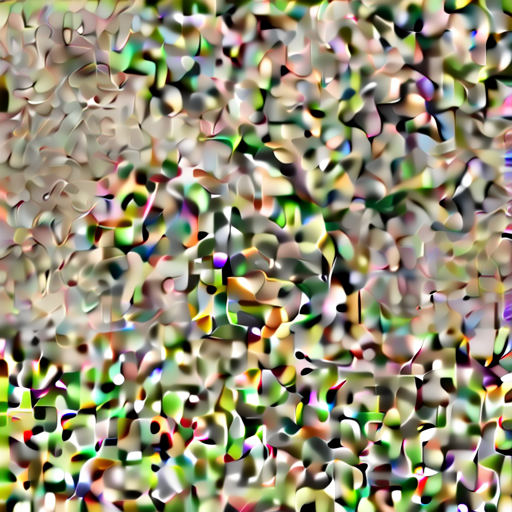

In [ ]:
to_pil_image(pipe.vae.decode(x[0].to(torch.bfloat16) / pipe.vae.config.scaling_factor, return_dict=False)[0][0])

  0%|          | 0/50 [00:00<?, ?it/s]

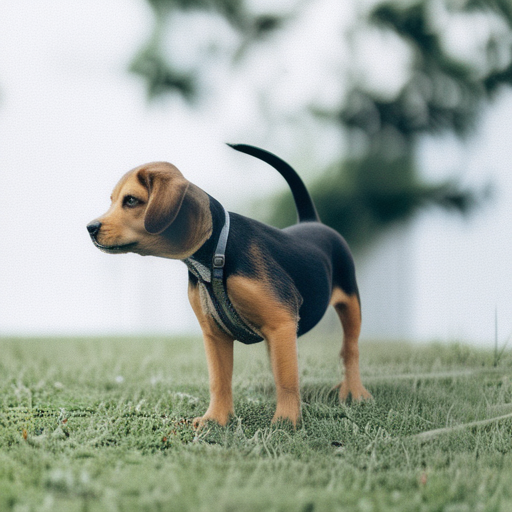

In [ ]:
pipe(prompt = "Photograph of a puppy on the grass", latents = x[0].clone(), guidance_scale = 1 ).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

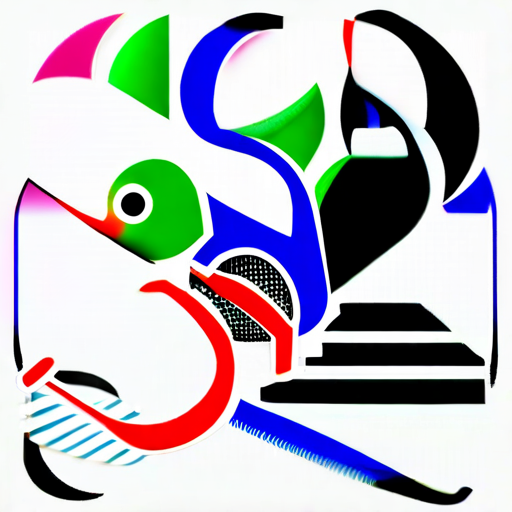

In [ ]:
pipe(prompt = "Photograph of a puppy on the grass", latents = inverted_latents.clone(), guidance_scale = 3.5 ).images[0]

In [ ]:
from tqdm import tqdm
input_image_prompt = "Photograph of a puppy on the grass"
negative_prompt = ""
invert_till = 50
inverted_latents = invert(
    l,
    input_image_prompt,
    num_inference_steps=50,
    invert_till=invert_till,
    negative_prompt = negative_prompt,
    )

  0%|          | 0/49 [00:00<?, ?it/s]

100%|██████████| 49/49 [00:03<00:00, 12.70it/s]


  0%|          | 0/39 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

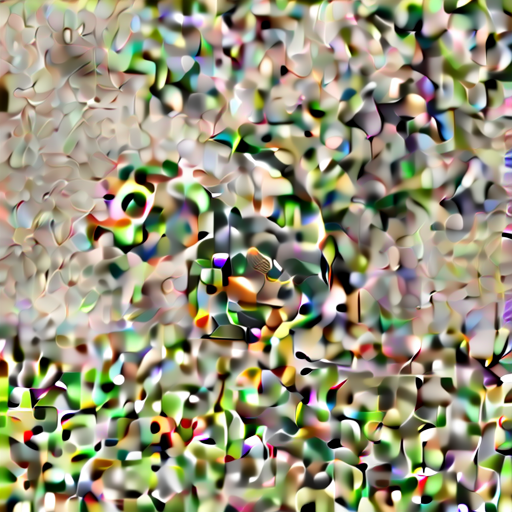

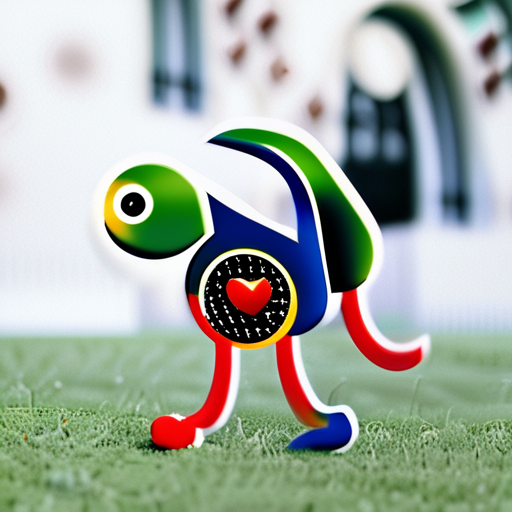

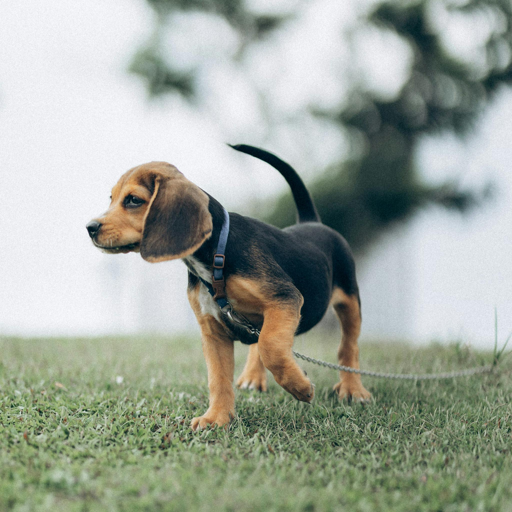

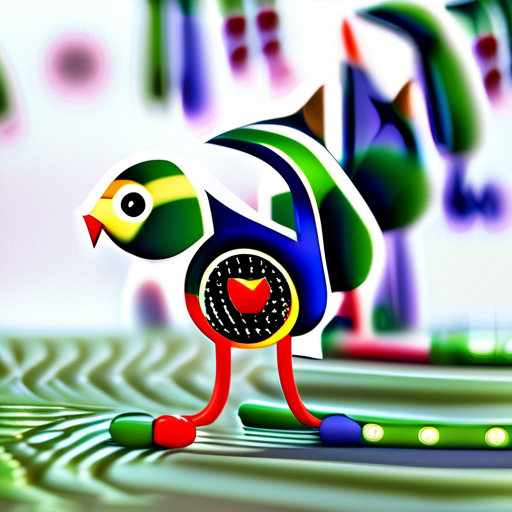

(None, None, None, None)

In [ ]:
input_image_prompt = "Photograph of a puppy on the grass"
negative_prompt = "blurry, ugly, low-quality, bad anatomy, distorted, deformed, text, watermark, logo, jpeg artifacts, overexposed, underexposed, grainy, pixelated, cartoonish, unrealistic, stock photo, poor lighting"
negative_prompt = ""
invert_till = 40
inverted_latents = invert(
    l,
    input_image_prompt,
    num_inference_steps=50,
    invert_till=invert_till,
    negative_prompt = negative_prompt
    )
images = pipe.vae.decode(inverted_latents / pipe.vae.config.scaling_factor, return_dict=False)[0]
inverted_image = [to_pil_image(img) for img in images][0]

start_step = 50 - invert_till
reverted_image = sample(
    input_image_prompt,
    start_latents=inverted_latents,
    start_step=start_step,
    num_inference_steps=50,
    negative_prompt = negative_prompt
)[0]

new_prompt = input_image_prompt.replace("puppy", "cat")
edited_image = sample(
    new_prompt,
    start_latents=inverted_latents,
    start_step=start_step,
    num_inference_steps=50,
    negative_prompt = negative_prompt
)[0]

inverted_image.show(), reverted_image.show(), input_image.show(), edited_image.show()

In [ ]:
# def edit(input_image, input_image_prompt, edit_prompt, num_steps=100, start_step=30, guidance_scale=3.5):
#     with torch.no_grad():
#         latent = pipe.vae.encode(tfms.functional.to_tensor(input_image).unsqueeze(0).to(device) * 2 - 1)
#     l = 0.18215 * latent.latent_dist.sample()
#     inverted_latents = invert(l, input_image_prompt, num_inference_steps=num_steps)
#     final_im = sample(
#         edit_prompt,
#         start_latents=inverted_latents[-(start_step + 1)][None],
#         start_step=start_step,
#         num_inference_steps=num_steps,
#         guidance_scale=guidance_scale,
#     )[0]
#     return final_im

In [ ]:
# edit(input_image, "A puppy on the grass", "an old grey dog on the grass", num_steps=50, start_step=10)
# edit(input_image, "A puppy on the grass", "A blue dog on the lawn", num_steps=50, start_step=12, guidance_scale=6)

# My Model

In [ ]:
# update failed_captions.txt file, also change code in update_text_embeddings to change not only 'woman' but also "woman's", ' woman', ...
# change model forward code
# change model training code (training loop, dataloader, loss function)

In [ ]:
# import os
# os.environ["TORCH_HOME"] = "weights/"  # for PyTorch model zoo / torchvision / LPIPS
# os.environ["HF_HOME", "TRANSFORMERS_CACHE"] = "weights/"  # for Hugging Face Transformers & Diffusers

In [ ]:
from model import MyStableDiffusionXLPipeline
import torch
from PIL import Image
import requests
from io import BytesIO

pipe = MyStableDiffusionXLPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.bfloat16, use_safetensors=True, cache_dir='weights', config_path = 'model_config.yaml').to('cuda:7')
# g = torch.Generator(device='cuda').manual_seed(0)

def load_image(url, size=None):
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    if size:
        img = img.resize(size)
    return img
input_image = load_image("https://images.pexels.com/photos/8306128/pexels-photo-8306128.jpeg", size=(512, 512))
# input_image
for p in pipe.parameters():
    p.requires_grad = False
for p in pipe.trainable_parameters():
    p.requires_grad = True

In [ ]:
img = Image.open("similar_images/emma_1.jpg").convert("RGB").resize((1024, 1024))
mask = torch.randint(0, 1, (1024, 1024), device = 'cuda')
prompt = "Image of a woman with hairstyle"

# with torch.no_grad():
output_images, io_masks = pipe.forward([img], [mask], [img], [mask], [prompt], [prompt], invert_till = 1, output_type = 'tensor_image')
# output[0][0]

In [ ]:
negative_prompt = "blurry, ugly, low-quality, bad anatomy, distorted, deformed, text, watermark, logo, jpeg artifacts, overexposed, underexposed, grainy, pixelated, cartoonish, unrealistic, stock photo, poor lighting"
img = pipe.sample("image of person standing in front of a red car, wearing black cap", negative_prompt = negative_prompt, guidance_scale=3.5, do_classifier_free_guidance=True, output_type = "tensor_image")
img.shape

In [ ]:
input_image_prompt = "Photograph of a puppy on the grass"
invert_till = 40
with torch.no_grad():
    inverted_latents = pipe.invert(images = [input_image], prompt = [input_image_prompt], invert_till=invert_till)
    img = pipe.sample(prompt = input_image_prompt, start_step = 50 - invert_till, start_latents = inverted_latents.clone())[0]
img

In [ ]:
img1 = Image.open("similar_images/emma_1.jpg").convert("RGB").resize((1024, 1024))
img2 = Image.open("similar_images/emma_2.jpg").convert("RGB").resize((1024, 1024))
mask = torch.randint(0, 1, (1024, 1024), device = 'cuda')
prompt = "Image of a woman with hairstyle"
io_mask = pipe.get_io_mask(torch.randn((1, 4, 128, 128), device = 'cuda', dtype = torch.bfloat16), 40, [img1], mask, [img], mask, 3.5, [prompt], [prompt], 0.6, 1.2)
Image.fromarray((io_mask.squeeze(0).cpu().numpy() * 255).astype('uint8')).show() # [1, 128, 128]
io_mask.shape

In [ ]:
img = Image.open("similar_images/emma_1.jpg").convert("RGB").resize((1024, 1024))
mask = torch.randint(0, 1, (1024, 1024), device = 'cuda')
prompt = "Image of a woman with hairstyle"

# with torch.no_grad():
output_images, io_masks = pipe.forward([img], [mask], [img], [mask], [prompt], [prompt], invert_till = 1, output_type = 'tensor_image')
# output[0][0]

In [ ]:
from loss_function import LossFunction
loss_function = LossFunction(model = pipe, device = "cuda")

img1 = Image.open("similar_images/emma_1.jpg").convert("RGB").resize((1024, 1024))
img2 = Image.open("similar_images/scarlet_2.png").convert("RGB").resize((1024, 1024))
mask1 = torch.randint(0, 1, (1024, 1024))
mask2= torch.randint(0, 1, (128, 128))
loss, loss_dict = loss_function([img1], [img2], [img2], [mask1], [mask2], [mask1], [mask2], True)
loss_dict # 1.61 s ± 103 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)

In [ ]:
import torch
a = torch.tensor(2.0, requires_grad = True)
b = torch.tensor(5.0, requires_grad = True)

# b = torch.tensor(640.0, requires_grad = True)
# for _ in range(3):
#     b = b * a

for i in range(10):
    if (i > 4) and (i < 7): # 2 steps
        with torch.no_grad():
            b = b * a
    else:
        b = b * a

# from torchviz import make_dot
# dot = make_dot(b)
# dot.save('graph.dot') # dot -Tpng graph.dot -o graph.png

b.backward()
a.grad # even if you keep (i > 0) and (i < 7) same result

# Masks

In [102]:
import numpy as np
def process_mask(mask_path: str):
    mask = Image.open(mask_path).convert("RGB")
    mask = mask.crop((0, 0, 512, 512))
    mask = mask.resize((1024, 1024), resample=Image.NEAREST)
    mask_np = np.array(mask)
    BLUE = np.array([16, 78, 139])
    GREEN = np.array([0, 100, 0])
    face_mask = (
        np.all(mask_np == BLUE, axis=-1) |
        np.all(mask_np == GREEN, axis=-1)
    ).astype(np.uint8)
    return face_mask

mask = process_mask("/workspace/small_shhq/masks/image_000001.png")
image = Image.open("/workspace/small_shhq/images/image_000001.jpg")
masked_image = pipe.apply_masks([image], [1 - mask])[0]
mask2 = process_mask("/workspace/small_shhq/masks/image_000002.png")
image2 = Image.open("/workspace/small_shhq/images/image_000002.jpeg")
masked_image2 = pipe.apply_masks([image], [1 - mask])[0]
# Image.fromarray(mask*255)
# masked_image

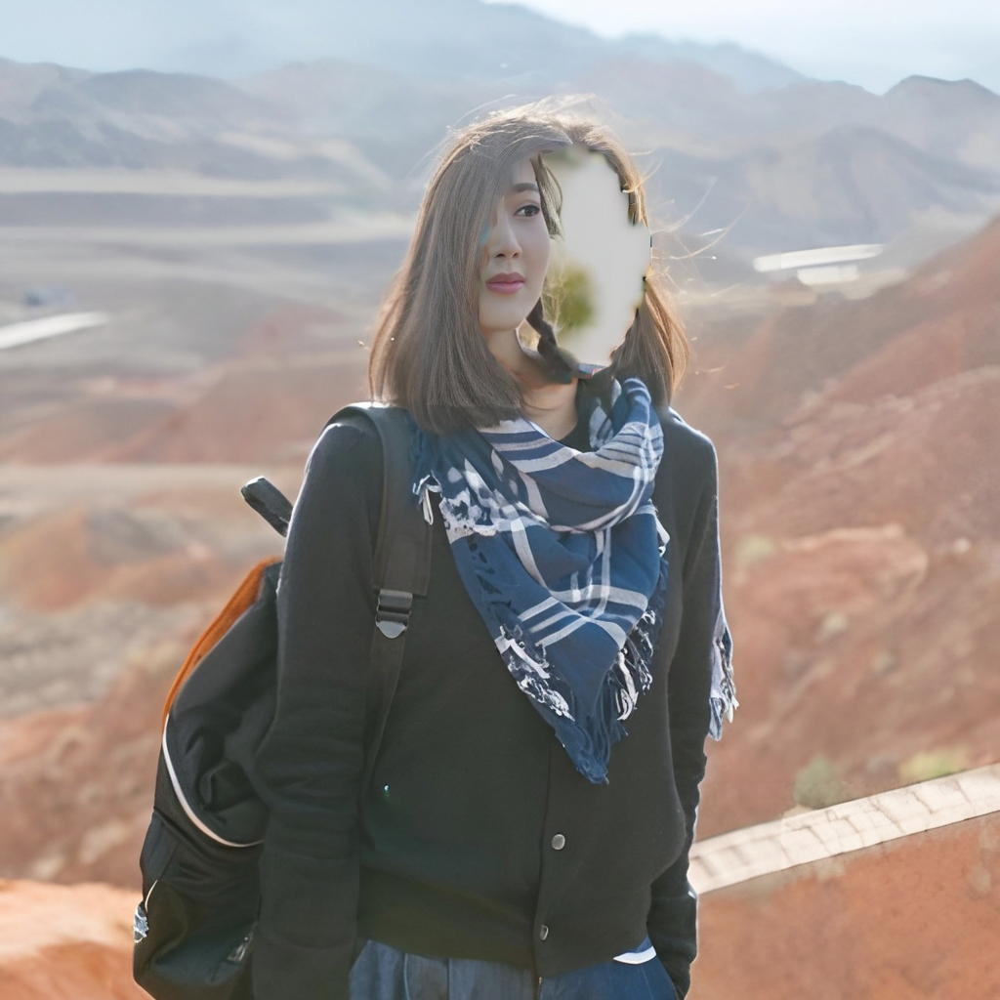

In [105]:
encoded_img, encoded_img2 = pipe.encode_images([image, image2])

downsampled_mask = torch.tensor(np.array(Image.fromarray(mask).resize((128, 128), resample=Image.BILINEAR)), device = 'cuda')
downsampled_mask2 = torch.tensor(np.array(Image.fromarray(mask2).resize((128, 128), resample=Image.BILINEAR)), device = 'cuda')
encoded_masked_img_ = (encoded_img * (1 - downsampled_mask) + encoded_img2 * (downsampled_mask)).unsqueeze(0)
# encoded_masked_img_ = (encoded_img * (downsampled_mask)).unsqueeze(0)
decoded_face_image = pipe.decode_images(encoded_masked_img_)
decoded_face_image = pipe.to_pil_image_batch([decoded_face_image[0]])[0]
decoded_face_image

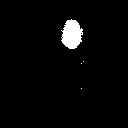

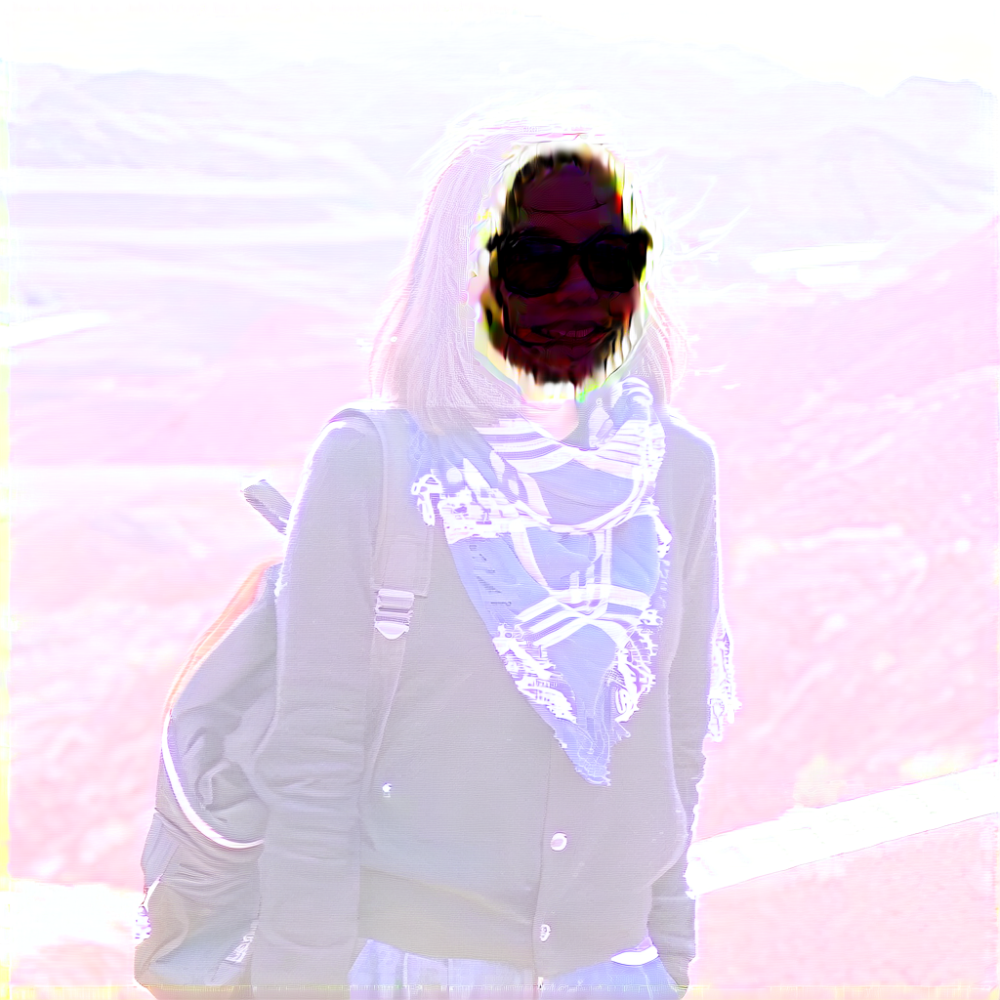

In [ ]:
encoded_img, encoded_masked_img = pipe.encode_images([image, masked_image])

target_mask = torch.norm(encoded_img - encoded_masked_img, dim = 0)
mag_min = target_mask.amin(keepdim=True)
mag_max = target_mask.amax(keepdim=True)
target_mask = (target_mask - mag_min) / (mag_max - mag_min + 1e-8)
target_mask = (target_mask >= 0.5)
Image.fromarray((target_mask*255).float().cpu().numpy()).show()

encoded_mask = pipe.encode_images([Image.fromarray((np.array([mask, mask, mask])*255).transpose(1, 2, 0))])[0]
decoded_face_image = pipe.decode_images((encoded_img - encoded_mask).unsqueeze(0))
decoded_face_image = pipe.to_pil_image_batch([decoded_face_image[0]])[0]
decoded_face_image

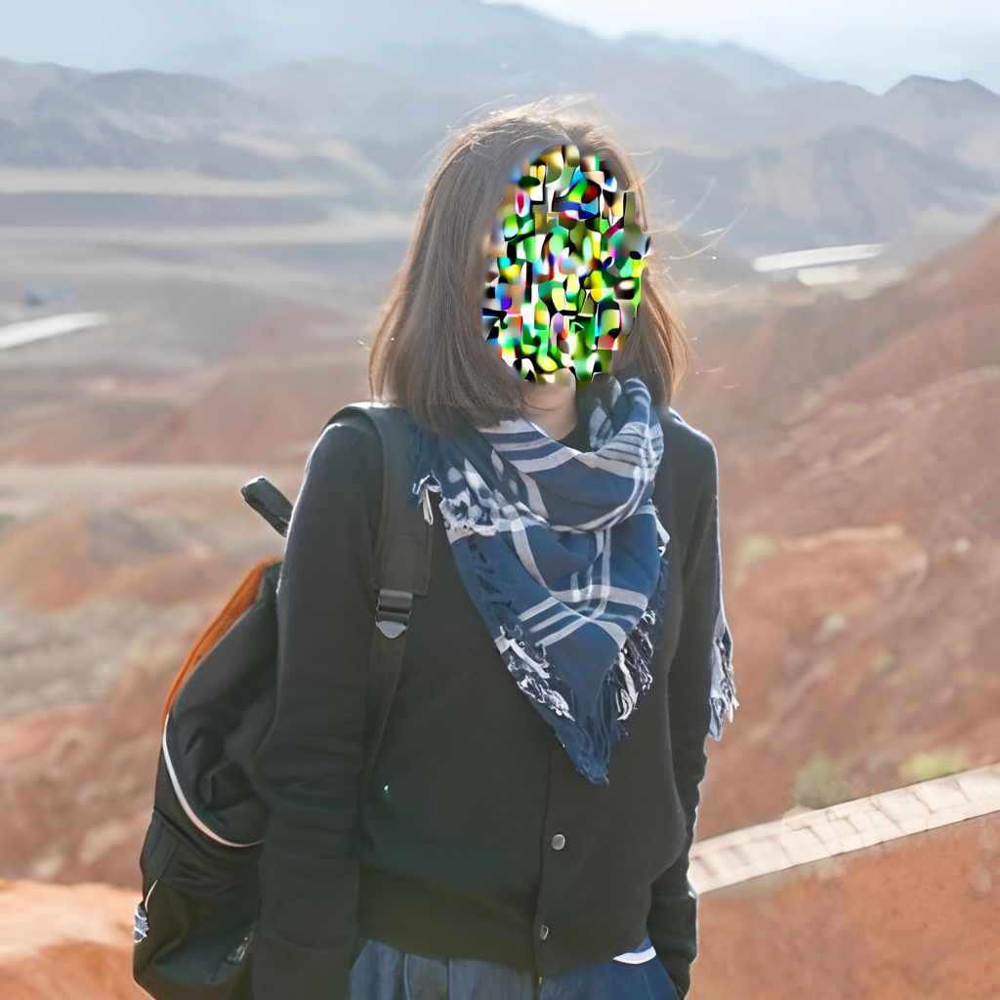

In [ ]:
downsampled_mask = torch.tensor(np.array(Image.fromarray(mask).resize((128, 128), resample=Image.BILINEAR)), device = 'cuda')
noise = torch.randn_like(encoded_img)
encoded_masked_img_ = (encoded_img * (1 - downsampled_mask) + noise * (downsampled_mask)).unsqueeze(0)
# encoded_masked_img_ = (encoded_img * (downsampled_mask)).unsqueeze(0)
decoded_face_image = pipe.decode_images(encoded_masked_img_)
decoded_face_image = pipe.to_pil_image_batch([decoded_face_image[0]])[0]
decoded_face_image

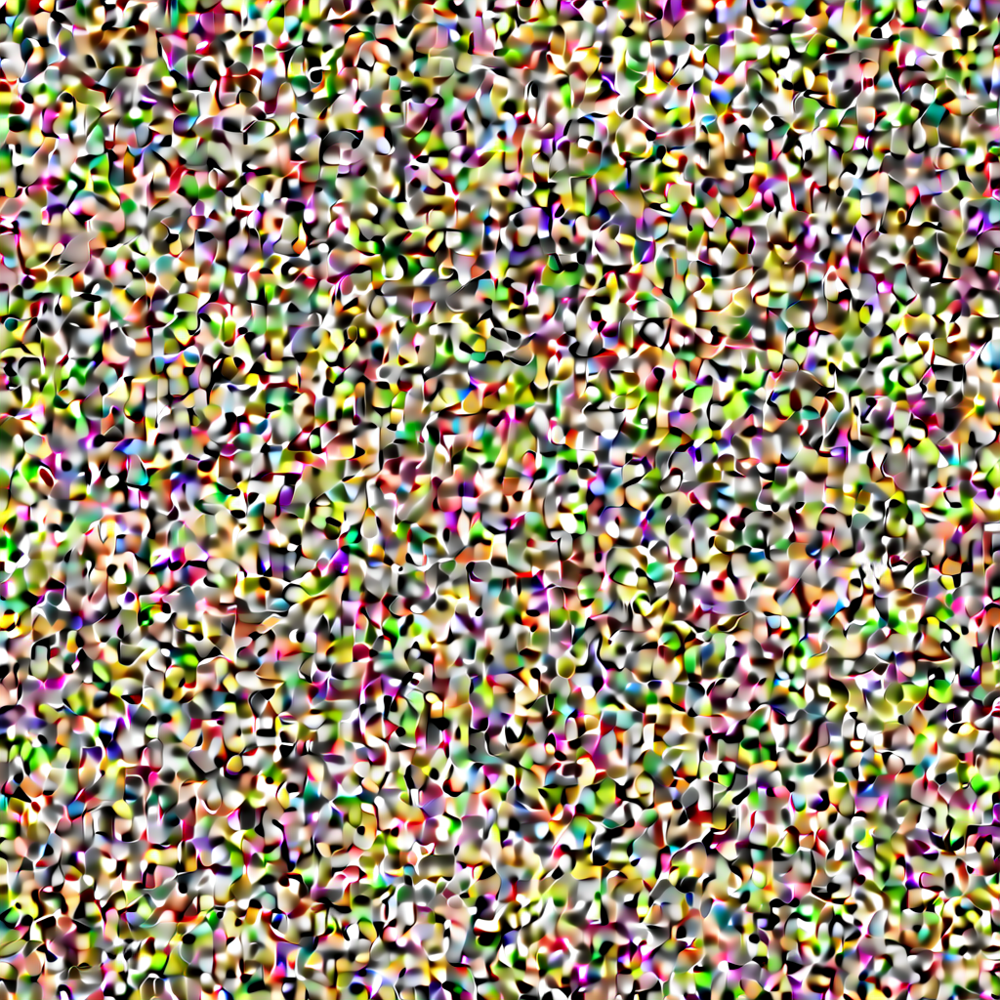

In [85]:
noise = torch.randn((4, 128, 128), dtype = torch.bfloat16, device = 'cuda').unsqueeze(0)
decoded_face_image = pipe.decode_images(noise)
decoded_face_image = pipe.to_pil_image_batch([decoded_face_image][0])[0]
decoded_face_image

# DataLoader testing

In [1]:
from dataloader import DataLoader
from PIL import Image
dataloader = DataLoader()
# len(dataloader.female_files), len(dataloader.male_files), len(dataloader.image_files), len(dataloader.mask_files), len(dataloader.caption_files)
body_images, head_images, head_images_hair_masks, body_images_hair_masks, body_image_captions, head_images_captions, head_images_face_masks, head_masks = dataloader.get_train_batch()
def overlay_mask_on_image(body_image, head_mask, size=(512, 512), mask_color=(255, 0, 0, 120)):
    """
    Overlay a binary mask on top of a body image.

    Args:
        body_image: PIL Image
        head_mask: numpy array (H, W) with 0/1
        size: tuple, output size (width, height)
        mask_color: RGBA tuple for the overlay color

    Returns:
        blended_image: PIL Image with mask overlay
    """
    # Resize body image and convert to RGBA
    body_img = body_image.resize(size).convert("RGBA")
    
    # Convert mask to RGBA overlay
    mask_img = Image.fromarray((head_mask * 255).astype('uint8')).resize(size)
    overlay = Image.new("RGBA", size, (0, 0, 0, 0))
    overlay_data = overlay.load()
    mask_data = mask_img.load()

    for y in range(size[1]):
        for x in range(size[0]):
            if mask_data[x, y] > 0:
                overlay_data[x, y] = mask_color

    # Blend
    blended = Image.alpha_composite(body_img, overlay)
    return blended
# body_images[0]

Total Image files in dataset are 39207
Total train image files are 35286
Total test image files are 3921


In [ ]:
i = 1
size=(512, 512)
# body_images[i].resize(size)
# head_images[i].resize(size)
# Image.fromarray((head_masks[i] * 255).astype('uint8')).resize(size)
# overlay_mask_on_image(body_images[i], head_masks[i])
combined = Image.new("RGB", (1024, 1024))
combined.paste(body_images[i].resize(size), (0, 0))
combined.paste(head_images[i].resize(size), (512, 0))
combined.paste(Image.fromarray((head_masks[i] * 255).astype('uint8')).resize(size), (0, 512))
combined.paste(overlay_mask_on_image(body_images[i], head_masks[i]), (512, 512))
combined.show()

In [32]:
%%timeit
body_images, head_images, head_images_hair_masks, body_images_hair_masks, body_image_captions, head_images_captions, head_images_face_masks, head_masks = dataloader.get_train_batch()

1.01 s ± 21.2 ms per loop (mean ± std. dev. of 7 runs, 1 loop each)


In [ ]:
from dataloader import DataLoader, PrefetchDataLoader

dl = DataLoader(batch_size=4)

train_loader = PrefetchDataLoader(dl, mode="train", num_workers=2, prefetch_batches=4)

Total Image files in dataset are 39207
Total train image files are 35286
Total test image files are 3921


In [ ]:
import time
N = 20
start = time.time()
for _ in range(N):
    # batch = next(train_loader) # 0.3250s
    batch = dl.get_train_batch() # 0.9946s
end = time.time()
print(f"Avg batch time: {(end - start)/N:.4f} sec")

Avg batch time: 0.9946 sec


In [ ]:
train_loader.shutdown()

# ddim inversion sdv1.5

In [ ]:
import torch
import requests
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from io import BytesIO
from tqdm.auto import tqdm
from matplotlib import pyplot as plt
from torchvision import transforms as tfms
from diffusers import StableDiffusionPipeline, DDIMScheduler


# Useful function for later
def load_image(url, size=None):
    response = requests.get(url, timeout=0.2)
    img = Image.open(BytesIO(response.content)).convert("RGB")
    if size is not None:
        img = img.resize(size)
    return img

device = torch.device("mps" if torch.backends.mps.is_available() else "cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
# Load a pipeline
pipe = StableDiffusionPipeline.from_pretrained("runwayml/stable-diffusion-v1-5").to(device)
# Set up a DDIM scheduler
pipe.scheduler = DDIMScheduler.from_config(pipe.scheduler.config)

  0%|          | 0/50 [00:00<?, ?it/s]

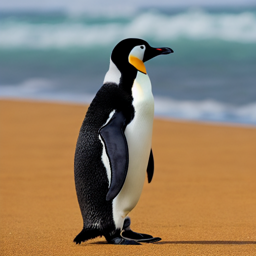

In [ ]:
# Sample an image to make sure it is all working
prompt = "Beautiful DSLR Photograph of a penguin on the beach, golden hour"
negative_prompt = "blurry, ugly, stock photo"
im = pipe(prompt, negative_prompt=negative_prompt).images[0]
im.resize((256, 256))  # Resize for convenient viewing

In [ ]:
# Sample function (regular DDIM)
@torch.no_grad()
def sample(
    prompt,
    start_step=0,
    start_latents=None,
    guidance_scale=3.5,
    num_inference_steps=30,
    num_images_per_prompt=1,
    do_classifier_free_guidance=True,
    negative_prompt="",
    device=device,
):

    # Encode prompt
    text_embeddings = pipe._encode_prompt(
        prompt, device, num_images_per_prompt, do_classifier_free_guidance, negative_prompt
    )

    # Set num inference steps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)

    # Create a random starting point if we don't have one already
    if start_latents is None:
        start_latents = torch.randn(1, 4, 64, 64, device=device)
        start_latents *= pipe.scheduler.init_noise_sigma

    latents = start_latents.clone()

    for i in tqdm(range(start_step, num_inference_steps)):

        t = pipe.scheduler.timesteps[i]

        # Expand the latents if we are doing classifier free guidance
        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

        # Predict the noise residual
        noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

        # Perform guidance
        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        # Normally we'd rely on the scheduler to handle the update step:
        # latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample

        # Instead, let's do it ourselves:
        prev_t = max(1, t.item() - (1000 // num_inference_steps))  # t-1
        alpha_t = pipe.scheduler.alphas_cumprod[t.item()]
        alpha_t_prev = pipe.scheduler.alphas_cumprod[prev_t]
        predicted_x0 = (latents - (1 - alpha_t).sqrt() * noise_pred) / alpha_t.sqrt()
        direction_pointing_to_xt = (1 - alpha_t_prev).sqrt() * noise_pred
        latents = alpha_t_prev.sqrt() * predicted_x0 + direction_pointing_to_xt

    # Post-processing
    images = pipe.decode_latents(latents)
    images = pipe.numpy_to_pil(images)

    return images

/workspace/env/lib/python3.11/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:313: FutureWarning: `_encode_prompt()` is deprecated and it will be removed in a future version. Use `encode_prompt()` instead. Also, be aware that the output format changed from a concatenated tensor to a tuple.
  deprecate("_encode_prompt()", "1.0.0", deprecation_message, standard_warn=False)


  0%|          | 0/50 [00:00<?, ?it/s]

/workspace/env/lib/python3.11/site-packages/diffusers/pipelines/stable_diffusion/pipeline_stable_diffusion.py:599: FutureWarning: The decode_latents method is deprecated and will be removed in 1.0.0. Please use VaeImageProcessor.postprocess(...) instead
  deprecate("decode_latents", "1.0.0", deprecation_message, standard_warn=False)


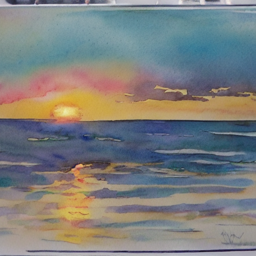

In [ ]:
# Test our sampling function by generating an image
sample("Watercolor painting of a beach sunset", negative_prompt=negative_prompt, num_inference_steps=50)[0].resize(
    (256, 256)
)

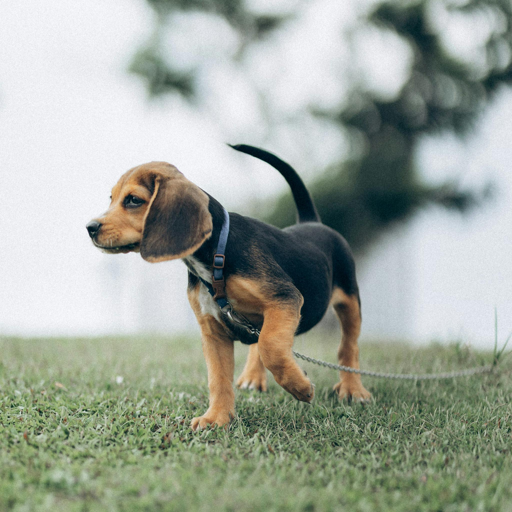

In [ ]:
# https://www.pexels.com/photo/a-beagle-on-green-grass-field-8306128/
input_image = load_image("https://images.pexels.com/photos/8306128/pexels-photo-8306128.jpeg", size=(512, 512))
input_image

In [ ]:
# Encode with VAE
with torch.no_grad():
    latent = pipe.vae.encode(tfms.functional.to_tensor(input_image).unsqueeze(0).to(device) * 2 - 1)
l = 0.18215 * latent.latent_dist.sample()

In [ ]:
## Inversion
@torch.no_grad()
def invert(
    start_latents,
    prompt,
    guidance_scale=3.5,
    num_inference_steps=80,
    num_images_per_prompt=1,
    do_classifier_free_guidance=True,
    negative_prompt="",
    device=device,
):

    # Encode prompt
    text_embeddings = pipe._encode_prompt(
        prompt, device, num_images_per_prompt, do_classifier_free_guidance, negative_prompt
    )

    # Latents are now the specified start latents
    latents = start_latents.clone()

    # We'll keep a list of the inverted latents as the process goes on
    intermediate_latents = []

    # Set num inference steps
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)

    # Reversed timesteps <<<<<<<<<<<<<<<<<<<<
    timesteps = reversed(pipe.scheduler.timesteps)

    for i in tqdm(range(1, num_inference_steps), total=num_inference_steps - 1):

        # We'll skip the final iteration
        if i >= num_inference_steps - 1:
            continue

        t = timesteps[i]

        # Expand the latents if we are doing classifier free guidance
        latent_model_input = torch.cat([latents] * 2) if do_classifier_free_guidance else latents
        latent_model_input = pipe.scheduler.scale_model_input(latent_model_input, t)

        # Predict the noise residual
        noise_pred = pipe.unet(latent_model_input, t, encoder_hidden_states=text_embeddings).sample

        # Perform guidance
        if do_classifier_free_guidance:
            noise_pred_uncond, noise_pred_text = noise_pred.chunk(2)
            noise_pred = noise_pred_uncond + guidance_scale * (noise_pred_text - noise_pred_uncond)

        current_t = max(0, t.item() - (1000 // num_inference_steps))  # t
        next_t = t  # min(999, t.item() + (1000//num_inference_steps)) # t+1
        alpha_t = pipe.scheduler.alphas_cumprod[current_t]
        alpha_t_next = pipe.scheduler.alphas_cumprod[next_t]

        # Inverted update step (re-arranging the update step to get x(t) (new latents) as a function of x(t-1) (current latents)
        latents = (latents - (1 - alpha_t).sqrt() * noise_pred) * (alpha_t_next.sqrt() / alpha_t.sqrt()) + (
            1 - alpha_t_next
        ).sqrt() * noise_pred

        # Store
        intermediate_latents.append(latents)

    return torch.cat(intermediate_latents)

In [ ]:
input_image_prompt = "Photograph of a puppy on the grass"
inverted_latents = invert(l, input_image_prompt, num_inference_steps=50)
inverted_latents.shape

  0%|          | 0/49 [00:00<?, ?it/s]

torch.Size([48, 4, 64, 64])

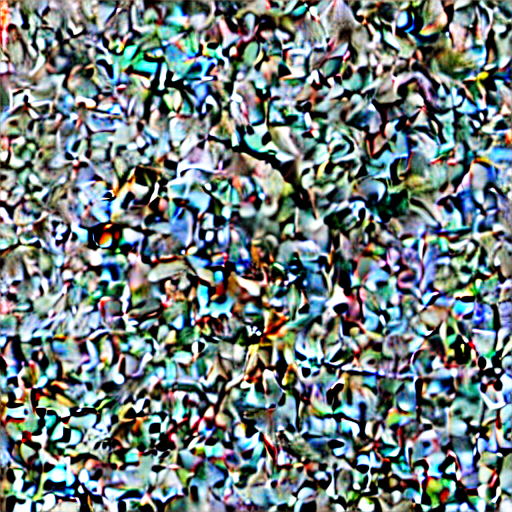

In [ ]:
# Decode the final inverted latents
with torch.no_grad():
    im = pipe.decode_latents(inverted_latents[-1].unsqueeze(0))
pipe.numpy_to_pil(im)[0]

  0%|          | 0/50 [00:00<?, ?it/s]

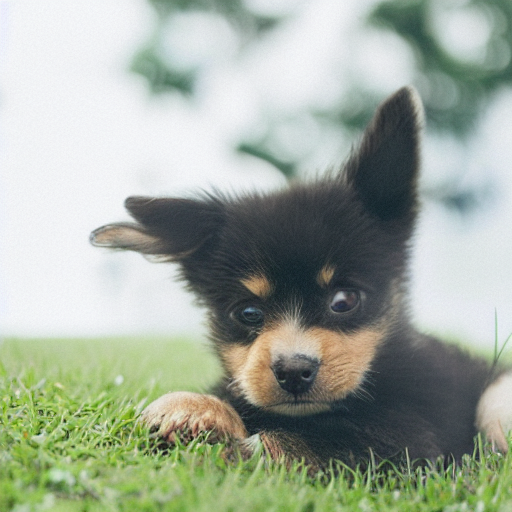

In [ ]:
pipe(input_image_prompt, latents=inverted_latents[-1][None], num_inference_steps=50, guidance_scale=3.5).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

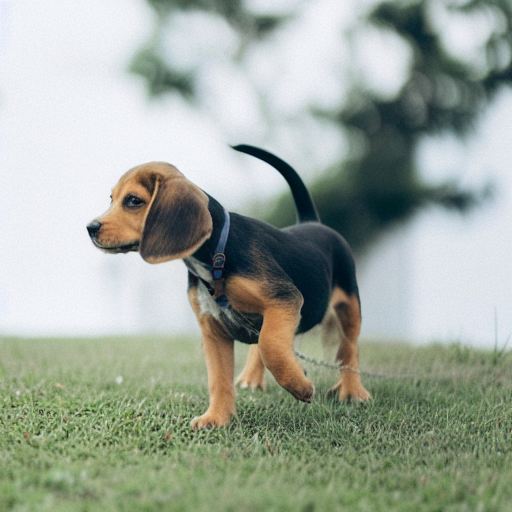

In [ ]:
# The reason we want to be able to specify start step
start_step = 20
sample(
    input_image_prompt,
    start_latents=inverted_latents[-(start_step + 1)][None],
    start_step=start_step,
    num_inference_steps=50,
)[0]

  0%|          | 0/40 [00:00<?, ?it/s]

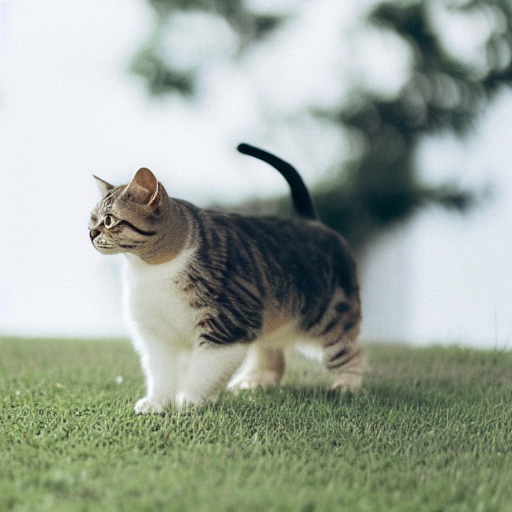

In [ ]:
# Sampling with a new prompt
start_step = 10
new_prompt = input_image_prompt.replace("puppy", "cat")
sample(
    new_prompt,
    start_latents=inverted_latents[-(start_step + 1)][None],
    start_step=start_step,
    num_inference_steps=50,
)[0]

  0%|          | 0/40 [00:00<?, ?it/s]

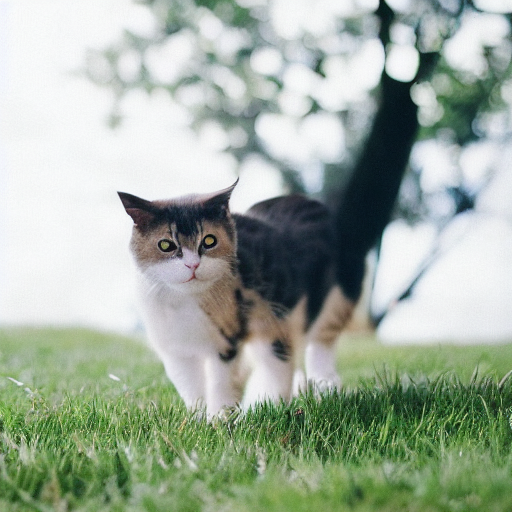

In [ ]:
start_step = 10
num_inference_steps = 50
pipe.scheduler.set_timesteps(num_inference_steps)
noisy_l = pipe.scheduler.add_noise(l, torch.randn_like(l), pipe.scheduler.timesteps[start_step])
sample(new_prompt, start_latents=noisy_l, start_step=start_step, num_inference_steps=num_inference_steps)[0]

In [ ]:
def edit(input_image, input_image_prompt, edit_prompt, num_steps=100, start_step=30, guidance_scale=3.5):
    with torch.no_grad():
        latent = pipe.vae.encode(tfms.functional.to_tensor(input_image).unsqueeze(0).to(device) * 2 - 1)
    l = 0.18215 * latent.latent_dist.sample()
    inverted_latents = invert(l, input_image_prompt, num_inference_steps=num_steps)
    final_im = sample(
        edit_prompt,
        start_latents=inverted_latents[-(start_step + 1)][None],
        start_step=start_step,
        num_inference_steps=num_steps,
        guidance_scale=guidance_scale,
    )[0]
    return final_im

  0%|          | 0/49 [00:00<?, ?it/s]

  0%|          | 0/40 [00:00<?, ?it/s]

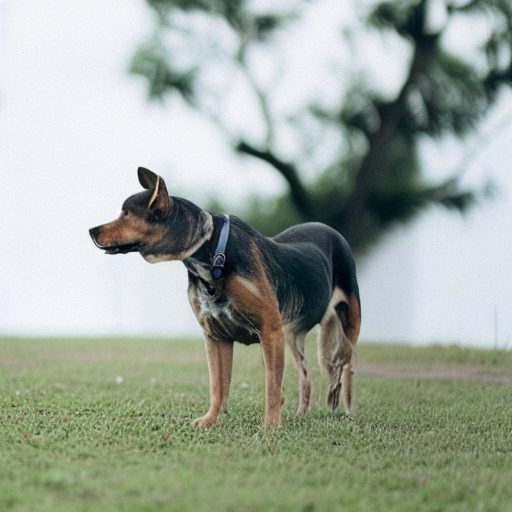

In [ ]:
edit(input_image, "A puppy on the grass", "an old grey dog on the grass", num_steps=50, start_step=10)

  0%|          | 0/149 [00:00<?, ?it/s]

  0%|          | 0/120 [00:00<?, ?it/s]

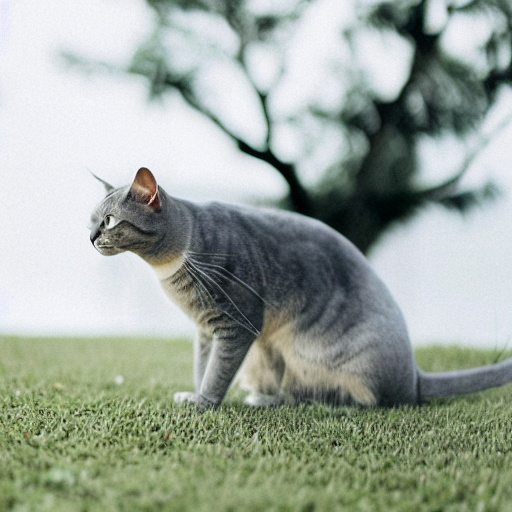

In [ ]:
edit(
    input_image,
    "A photograph of a puppy",
    "A photograph of a grey cat",
    num_steps=150,
    start_step=30,
    guidance_scale=5.5,
)

# modules

In [36]:
# for installing onnxruntime in docker environment pytorch image
# wget https://developer.download.nvidia.com/compute/cuda/repos/ubuntu2204/x86_64/cuda-keyring_1.1-1_all.deb
# dpkg -i cuda-keyring_1.1-1_all.de
# apt-get update
# apt-get install -y cuda-runtime-12-1 libcudnn8 libcudnn8-dev

# apt-get install -y build-essential python3-dev cmake git
# git clone --recursive https://github.com/microsoft/onnxruntime
# cd onnxruntime
# ./build.sh --config Release --build_wheel --use_cuda --cuda_version=12.1 --cudnn_home=/usr/lib/x86_64-linux-gnu
# pip install build/Linux/Release/dist/onnxruntime_gpu*.whl

# still didn't worked for insightface

import onnxruntime as ort
print(ort.get_available_providers())

['TensorrtExecutionProvider', 'CUDAExecutionProvider', 'AzureExecutionProvider', 'CPUExecutionProvider']


In [3]:
import numpy as np
from PIL import Image

image = Image.open("similar_images/emma_1.jpg").convert("RGB")
image_array = np.array(image)
print(image_array.shape)

(1920, 1260, 3)


In [ ]:
from modules.identity_encoder import InsightFaceEncoder
import torch
import numpy as np
from PIL import Image

encoder = InsightFaceEncoder()
# img = torch.randn((2, 3, 1024, 1024))
img = torch.tensor(np.array(Image.open("similar_images/emma_1.jpg").resize((1024, 1024)))).permute(2, 0, 1).unsqueeze(0)
embs = encoder(img)
embs.shape, encoder.num_parameters(), encoder.get_providers()

In [ ]:
from modules.clip_image_encoder import CLIPImageEncoder
import torch

encoder = CLIPImageEncoder(model_code="vit_l")
device = 'cpu'
encoder.to(device)
dummy_images = torch.rand((1, 3, 224, 224), device=device)
features = encoder(dummy_images)
print("Image feature vector shape:", features.shape, next(encoder.model.parameters()).device)

In [ ]:
from modules.hair_encoder import HairEncoder
import torch

device = "cuda"
hair_encoder = HairEncoder(weight_path="module_models/hair_encoder_weights.pt").to(device)
hair_encoder.eval()
out = hair_encoder(torch.rand((1, 3, 512, 512), device=device))
out.shape, next(hair_encoder.parameters()).device, sum(p.numel() for p in hair_encoder.parameters())

In [ ]:
from modules.adapters import HairEncoderAdapter
import torch

fusion_layer = HairEncoderAdapter()
device = "cuda"
fusion_layer = fusion_layer.to(device=device, dtype=torch.bfloat16)
fusion_layer(torch.randn((1, 18, 512), dtype=torch.bfloat16, device=device)).shape

In [ ]:
from modules.qformer import QFormer
import torch

qformer = QFormer(
    num_query_tokens=1,   # fuse into single token
    dim=2048,
    num_heads=8,
    num_layers=2,
    use_self_attn=False,
    mlp_ffn_ratio=2,
    refine_dim=None
)
qformer(torch.randn(2, 3, 2048)).shape, sum(p.numel() for p in qformer.parameters())

In [ ]:
from modules.schp_model import SCHPModel
from PIL import Image
model = SCHPModel(model_path="module_models/schp_model.pth")

img = Image.open("similar_images/emma_1.jpg")
# Single Image
parsed, face, hair = model.get_masks(img)
parsed.show(), face.show(), hair.show()
# Multi Image
# results = model.get_masks([img, img])
# for i, (parsed, face, hair) in enumerate(results):
#     parsed.show(), face.show(), hair.show()

In [ ]:
import lpips # Learned Perceptual Image Patch Similarity
from PIL import Image

# LPIPS score behavior
# measures perceptual similarity in deep feature space

# Two identical images (any content, human or not)
# → ~0.0 (close to zero, since features match).

# Two non-human images of the same scene/object (same identity)
# → small score (e.g., 0.01 – 0.1) depending on distortions (lighting, compression, blur).
# LPIPS is content-agnostic: it just looks at perceptual similarity.

# Two different non-human images (different objects/scenes)
# → larger score (~0.3 – 0.8+), depending on how different textures/structures are.

# Two images of the same human identity
# → small to moderate score (~0.05 – 0.2).
# Even with different poses/expressions, the features stay close in perceptual space.

# Two images of different human identities
# → larger score (~0.3 – 0.7).
# Faces look more different in feature space.

# Human vs non-human (cross-domain)
# → typically quite large (~0.5 – 1.0), since features from pretrained nets differ a lot.

# Human images with artifacts (blur, noise, compression) vs clean human
# → moderate score (~0.1 – 0.4 depending on artifact severity).
# LPIPS is sensitive to perceptual degradation.

loss_fn = lpips.LPIPS(net='alex')  # options: 'alex', 'vgg', 'squeeze'
loss_fn.to("cuda")
print(sum(p.numel() for p in loss_fn.parameters())) # 2470848

img1 = pipe.from_pil_image_batch([Image.open("similar_images/emma_2.jpg").convert("RGB").resize((1024, 1024))])
img2 = pipe.from_pil_image_batch([Image.open("similar_images/emma_1.jpg").convert("RGB").resize((1024, 1024))])
dist = loss_fn(img1, img2).view(-1)
dist

# Data gen models testing

In [ ]:
import torch
from diffusers import FluxKontextPipeline
from PIL import Image

pipe = FluxKontextPipeline.from_pretrained("black-forest-labs/FLUX.1-Kontext-dev", torch_dtype=torch.bfloat16, cache_dir = 'weights')
_ = pipe.to("cuda")

# pipe = torch.compile(pipe)

In [ ]:
with torch.no_grad():
  image = pipe(
    image=Image.open("small_shhq/images/image_000017.jpg"),
    prompt="Image of person standing in the library. Change the Expression, Pose, Outfit. Don't change the Hairstyle or Face identity.",
    guidance_scale=1.0,
    num_inference_steps=25
    # negative_prompt="blurry face"
  ).images[0]
image

In [ ]:
images_dir = "shhq_dataset/images"
save_dir = "shhq_dataset/gen_images"
image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:10]
total_files = len(image_files)
all_embeddings = None
for idx in tqdm(range(0, total_files)):
    image = os.path.join(images_dir, image_files[i])
    image.save(os.path.join(save_dir, image_files[i]))

In [ ]:
import os
from PIL import Image
images_dir = "shhq_dataset/gen_images"
other_images_dir = "shhq_dataset/images"
image_files = [f for f in os.listdir(images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))]
def combine_image(i):
    img1 = Image.open(os.path.join(other_images_dir, image_files[i])).resize((512, 512))
    img2 = Image.open(os.path.join(images_dir, image_files[i])).resize((512, 512))
    combined = Image.new("RGB", (img1.width + img2.width, img1.height))
    combined.paste(img1, (0, 0))
    combined.paste(img2, (img1.width, 0))
    return combined
combine_image(14)

# similarity based image clustering

In [ ]:
import os
import torch
import numpy as np
from tqdm import tqdm
from PIL import Image, ImageFilter
from modules.clip_image_encoder import CLIPImageEncoder

device = "cuda"
dtype = torch.bfloat16

def process_mask(mask_path: str):
    mask = Image.open(mask_path).convert("RGB")
    mask = mask.crop((0, 0, 512, 512))
    mask = mask.resize((1024, 1024), resample=Image.NEAREST)
    mask_np = np.array(mask)
    BLUE = np.array([16, 78, 139])
    GREEN = np.array([0, 100, 0])
    face_mask = (
        np.all(mask_np == BLUE, axis=-1) |
        np.all(mask_np == GREEN, axis=-1)
    ).astype(np.uint8)
    return face_mask

def to_pil(image_path):
    mask_path = image_path.split("/")
    mask_path[-2] = 'masks'
    mask_path[-1] = mask_path[-1].split('.')[0] + '.png'
    mask_path = "/".join(mask_path)

    face_mask = process_mask(mask_path)
    image = Image.open(image_path)
    blurred_image = image.filter(ImageFilter.GaussianBlur(radius=25))

    image = np.array(image)
    blurred_image = np.array(blurred_image)
    blurred_image[face_mask > 0] = image[face_mask > 0]
    tensor = torch.from_numpy(blurred_image.astype(np.float32) / 255.0).permute(2, 0, 1) # (512, 512, 3) -> (3, 512, 512)
    tensor = tensor * 2 - 1
    return tensor.to(device, dtype) # [-1 ,1]

encoder = CLIPImageEncoder().to(device, dtype)

In [ ]:
images_dir = "shhq_dataset/images"
batch_size = 128
image_files = [os.path.join(images_dir, f) for f in os.listdir(images_dir) if f.lower().endswith(('.png', '.jpg', '.jpeg'))][:1000]
total_files = len(image_files)
all_embeddings = None
for idx in tqdm(range(0, total_files + total_files % batch_size, batch_size)):
    image_files_list = [to_pil(image_files[i]) for i in range(idx, min(idx + batch_size, total_files))]
    if len(image_files_list) > 0:
        ip = torch.stack(image_files_list) 
        with torch.no_grad():
            embeddings = encoder(ip).cpu()
        if all_embeddings is not None:
            all_embeddings = torch.concat([all_embeddings, embeddings], dim = 0)
        else:
            all_embeddings = embeddings
all_embeddings.shape

In [65]:
import numpy as np
import faiss

def faiss_threshold_clustering(embeddings, threshold):
    faiss.normalize_L2(embeddings)
    N, D = embeddings.shape
    index = faiss.IndexFlatIP(D)
    index.add(embeddings)
    visited = np.zeros(N, dtype=bool)
    clusters = []
    for i in range(N):
        if visited[i]:
            continue
        D_i, I_i = index.search(embeddings[i:i+1], N)
        similar_idx = I_i[0][D_i[0] >= 1 - threshold]  # cosine similarity >= 1-threshold
        similar_idx = [idx for idx in similar_idx if not visited[idx]]
        if len(similar_idx) > 0:
            clusters.append(similar_idx)
            visited[similar_idx] = True
    return clusters

threshold = 0.1
clusters = faiss_threshold_clustering(all_embeddings.to(torch.float32).numpy(), threshold)
print(f"Number of clusters found: {len(clusters)}")
print(f"First cluster indexes: {clusters[0]}")

Number of clusters found: 915
First cluster indexes: [0, 918]


In [ ]:
Image.open(image_files[0]).resize((512, 512)).show(), Image.open(image_files[918]).resize((512, 512)).show()

In [ ]:
# pipe.unet.enable_gradient_checkpointing() # diffusers
# model.gradient_checkpointing_enable() # transformers

# Continue